<a href="https://colab.research.google.com/github/ronocara/helmet-Detection/blob/colab/Helmet_Detection_and_Classification_using_YOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# **Motorcycle Helmet Detection and Classification in the Philippines**

## **Preparation of Files and Environment**



In [ ]:
!git clone https://github.com/roginalddc22/yolov5  
%cd yolov5  
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow # install roboflow

Cloning into 'yolov5'...
remote: Enumerating objects: 9672, done.
remote: Total 9672 (delta 0), reused 0 (delta 0), pack-reused 9672
Receiving objects: 100% (9672/9672), 11.85 MiB | 15.00 MiB/s, done.
Resolving deltas: 100% (6499/6499), done.
/content/yolov5
     |████████████████████████████████| 1.6 MB 15.4 MB/s 
     |████████████████████████████████| 42 kB 992 kB/s 
     |████████████████████████████████| 138 kB 23.7 MB/s 
     |████████████████████████████████| 54 kB 2.3 MB/s 
     |████████████████████████████████| 145 kB 64.0 MB/s 
     |████████████████████████████████| 178 kB 72.0 MB/s 
     |████████████████████████████████| 67 kB 7.4 MB/s 
     |████████████████████████████████| 62 kB 1.7 MB/s 


In [ ]:
import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Setup complete. Using torch 1.13.0+cu116 (Tesla T4)


In [ ]:
from roboflow import Roboflow #import roboflow for our datasets
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [ ]:
#!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="RxMj5CyvMLmb4hSLTxva")
project = rf.workspace("cs173").project("helmets-k12dp")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/Helmets-1 in yolov5pytorch:: 100%|██████████| 4798/4798 [00:03<00:00, 1340.69it/s]


**Seperating dataset by parts**

seperated by time (5-6, 6-7, and 7-8 pm)

In [ ]:
import os
import glob
import shutil

parts = ["part1", "part2", "part3"]
folders = ["test", "train", "valid"]
subpart = ["images", "labels"]

for x in parts: 
  for y in folders:
    for z in subpart:
      source = "/content/datasets/Helmets-1/{}/{}".format(y,z)
      destination = "/content/datasets/Helmets-1/{}/{}/{}".format(x,y,z)
      allfiles = glob.glob(os.path.join(source, '{}*'.format(x)), recursive=True)
      print("Files to move", allfiles)
      
      if not os.path.exists(destination):
          os.makedirs(destination)
      for file_path in allfiles:
          dst_path = os.path.join(destination, os.path.basename(file_path))
          shutil.move(file_path, dst_path)
          print(f"Moved {file_path} -> {dst_path}")



In [ ]:
#yaml files for each part
parts = ["part1", "part2", "part3"]
for x in parts:
  source = "/content/datasets/Helmets-1/data.yaml"
  destination = "/content/datasets/Helmets-1/{}".format(x)
  shutil.copy2(source, destination)

after adding data.yaml files to each parts folder change test, train, and val paths


example: 

```
test: ../part2/test/images
train: /content/datasets/Helmets-1/part2/train/images
val: /content/datasets/Helmets-1/part2/valid/images
```




## **Training the Model**

 In this section, we will train the model using the train.py from the ultralytics repository. The model paremeters were already tuned to yield the best performing model version. The following hyperparameters were optimal for the model: 

1.  Image size = 416 pixels
2.  Batch size = 16
3.  Epochs = 50
4.  YOLOv5 Version = YOLOv5m (Medium)

  After the training process, the metrics of the model such as the precision, recall, and mAP score of the model is displayed using tensorboard. 

**Part 1 (5 - 6pm)**




In [ ]:
%cd 

/root


In [ ]:
#part 1 small
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 50 --data /content/datasets/Helmets-1/part1/data.yaml --weights yolov5s.pt --cache

In [ ]:
#Part 1 medium
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 50 --data /content/datasets/Helmets-1/part1/data.yaml --weights yolov5m.pt --cache

train: weights=yolov5m.pt, cfg=, data=/content/datasets/Helmets-1/part1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
remote: Enumerating objects: 4636, done.
remote: Counting objects: 100% (788/788), done.
remote: Compressing objects: 100% (49/49), done.
remote: Total 4636 (delta 754), reused 757 (delta 739), pack-reused 3848
Receiving objects: 100% (4636/4636), 1.82 MiB | 29.12 MiB/s, done.
Resolving deltas: 100% (3335/3335), completed with 112 local objects.
From https://github.com/ultralytic

In [ ]:
#part 1 large
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 50 --data /content/datasets/Helmets-1/part1/data.yaml --weights yolov5l.pt --cache

train: weights=yolov5l.pt, cfg=, data=/content/datasets/Helmets-1/part1/data.yaml, hyp=../content/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=../content/yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 338 commits. Use `git pull ultralytics master` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-355-gd3761df Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0

**Part 2 (6-7pm)**

In [ ]:
#part 2 small
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 50 --data /content/datasets/Helmets-1/part2/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/Helmets-1/part2/data.yaml, hyp=../content/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=../content/yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 338 commits. Use `git pull ultralytics master` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-355-gd3761df Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0

In [ ]:
#part 2 medium
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 50 --data /content/datasets/Helmets-1/part2/data.yaml --weights yolov5m.pt --cache

train: weights=yolov5m.pt, cfg=, data=/content/datasets/Helmets-1/part2/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 340 commits. Use `git pull ultralytics master` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-355-gd3761df Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cl

In [ ]:
#part 2 large
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 50 --data /content/datasets/Helmets-1/part2/data.yaml --weights yolov5l.pt --cache

train: weights=yolov5l.pt, cfg=, data=/content/datasets/Helmets-1/part2/data.yaml, hyp=../content/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=../content/yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 338 commits. Use `git pull ultralytics master` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-355-gd3761df Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0

**Part 3 (7-8pm)**

In [ ]:
#part 3 small
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 50 --data /content/datasets/Helmets-1/part3/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/Helmets-1/part3/data.yaml, hyp=../content/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=../content/yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 338 commits. Use `git pull ultralytics master` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-355-gd3761df Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0

In [ ]:
#part 3 medium
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 50 --data /content/datasets/Helmets-1/part3/data.yaml --weights yolov5m.pt --cache

train: weights=yolov5m.pt, cfg=, data=/content/datasets/Helmets-1/part3/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 340 commits. Use `git pull ultralytics master` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-355-gd3761df Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cl

In [ ]:
#part 3 large
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 50 --data /content/datasets/Helmets-1/part3/data.yaml --weights yolov5l.pt --cache

train: weights=yolov5l.pt, cfg=, data=/content/datasets/Helmets-1/part3/data.yaml, hyp=../content/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=../content/yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 338 commits. Use `git pull ultralytics master` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-355-gd3761df Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0

### **TensorBoard**

In this section, we will discuss the metrics of the model shown in tensorboard. Firstly, we will see the scalar metrics of the model such as mAP (mean average precision), precision, and recall. This metrics will determine if trained model is overfitting or underfitting. Next is the images, here we will be able to see the graphs of the performance of the model such as F1 curve, P curve, Confusion matrix, and the overall results of the model. Lastly, in the time series tab, all the graphs are shown from all the runtimes of the model training.

In [ ]:
%reload_ext tensorboard

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%reload_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

## **Testing the Model**

In this section, the model is tested using the testing dataset, consisting of frames from a video captured from Gil Puyat Avenue, Makati.The test dataset wil be used to measure the performance metrics of the model as well as the detection capabilities of the model. The metrics will be provided, as well as the confusion matrix of the detections of the model. The detect.py from the ultralytics repository will be used to detect and predict the bounding boxes from the test images. The images with the bounding boxes are also displayed below. The model could also be saved and downloaded to the users machine. 

In [ ]:
#detecting and predicting using the test dataset
#part 1 - medium
!python /content/yolov5/detect.py --weights /content/yolov5/runs/train/exp3/weights/best.pt --img 416 --conf 0.1 --source /content/datasets/Helmets-1/part3/test/images

detect: weights=['/content/yolov5/runs/train/exp3/weights/best.pt'], source=/content/datasets/Helmets-1/part3/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-355-gd3761df Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 290 layers, 20869098 parameters, 0 gradients, 47.9 GFLOPs
image 1/31 /content/datasets/Helmets-1/part3/test/images/part3_Trim2_mp4-106_jpg.rf.82dfa3cbaf1c682628ff5da5b1ea39a3.jpg: 256x416 1 motorcycle rider, Done. (0.015s)
image 2/31 /content/datasets/Helmets-1/part3/test/images/part3_Trim2_mp4-126_jpg.rf.075972bb654f53a2f7c0d1d4f2ec8111.jpg: 256x416 1 full-faced, 2 half-f

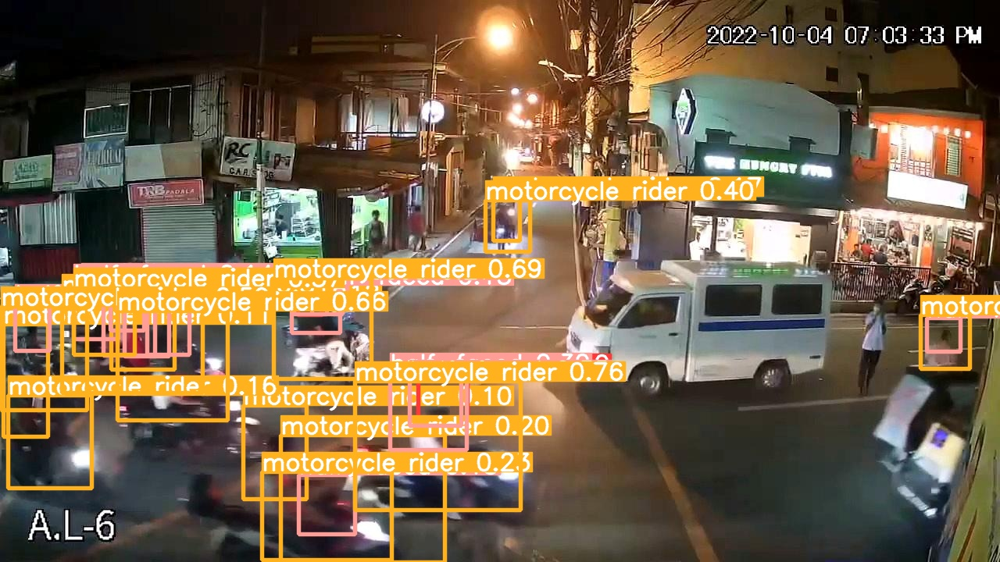

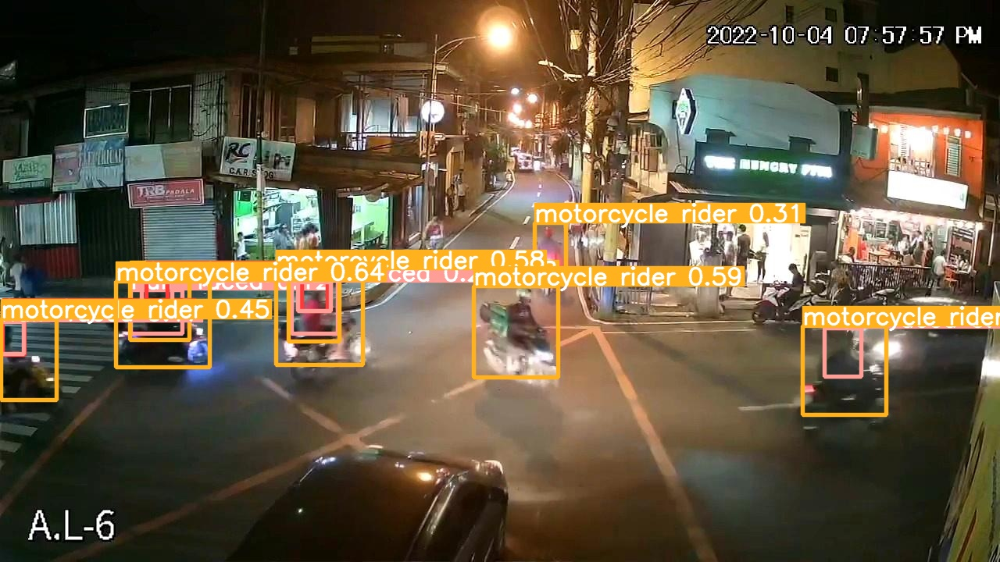

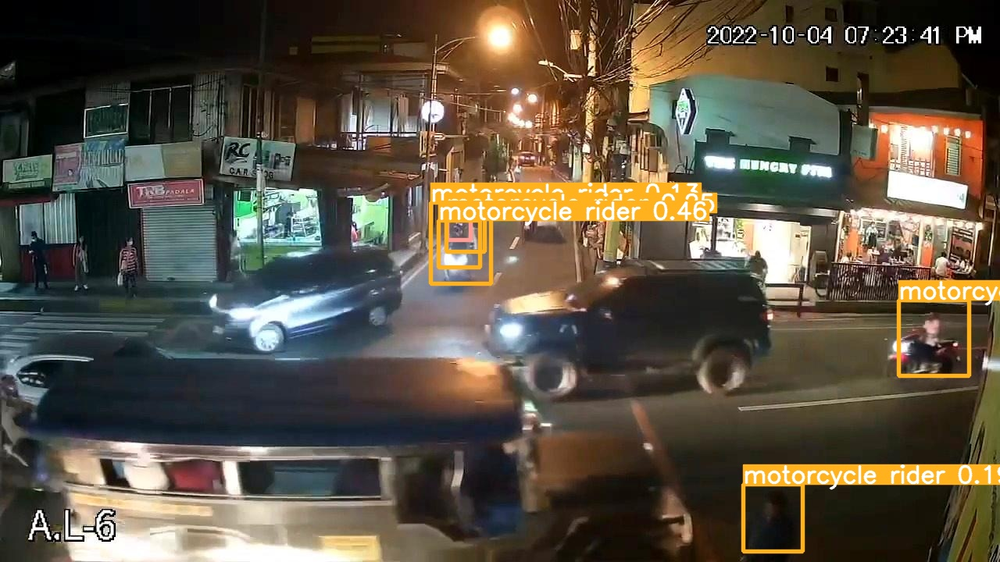

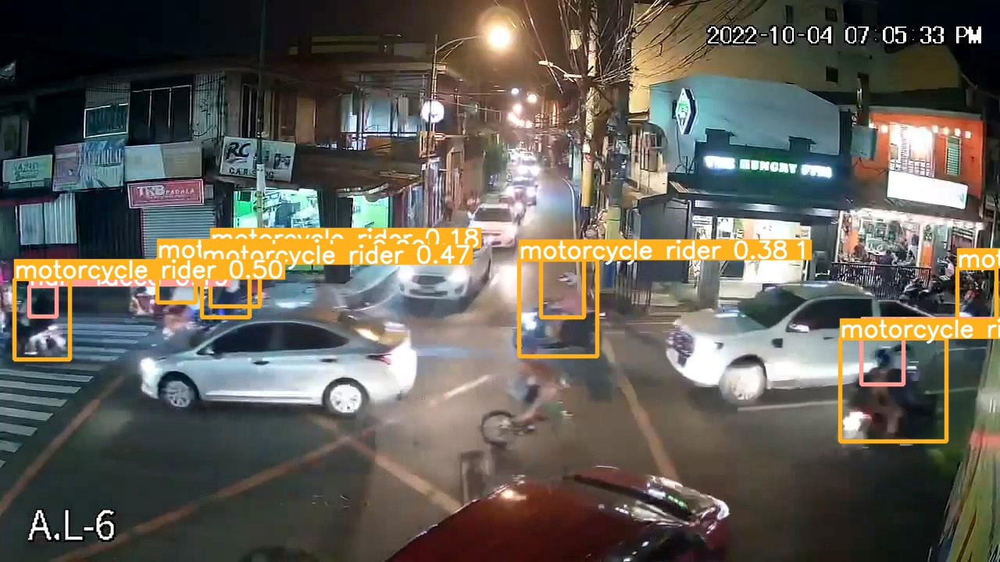

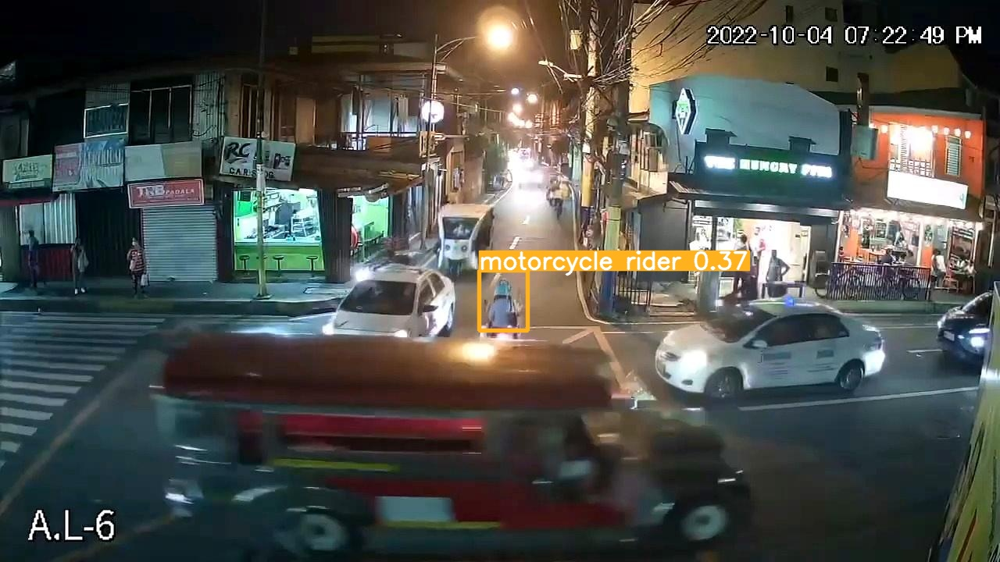

...

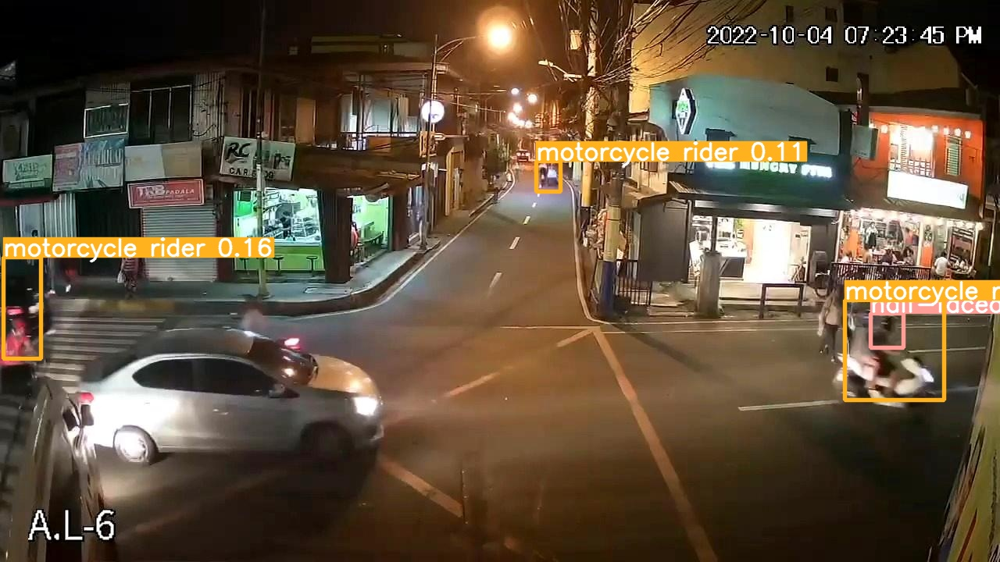

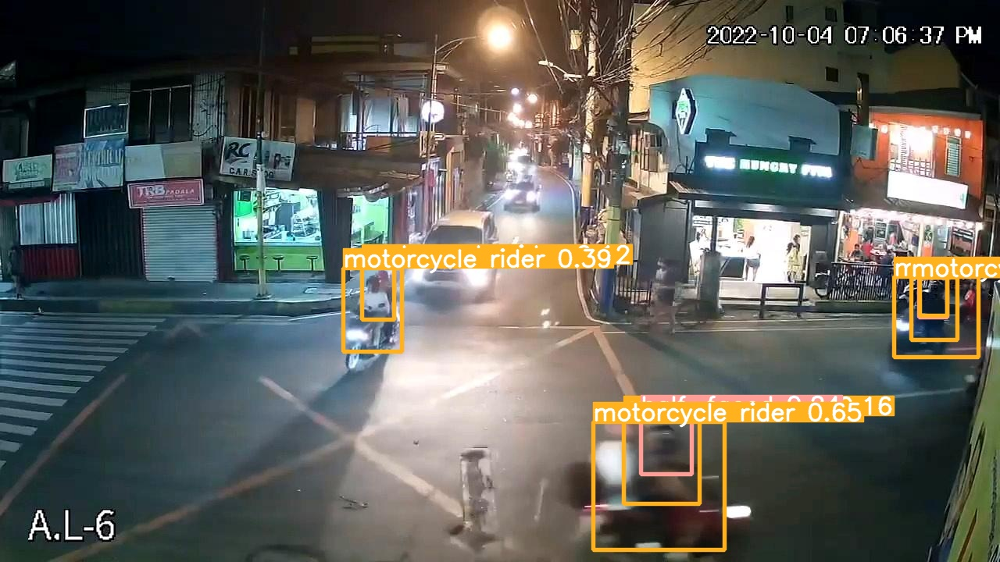

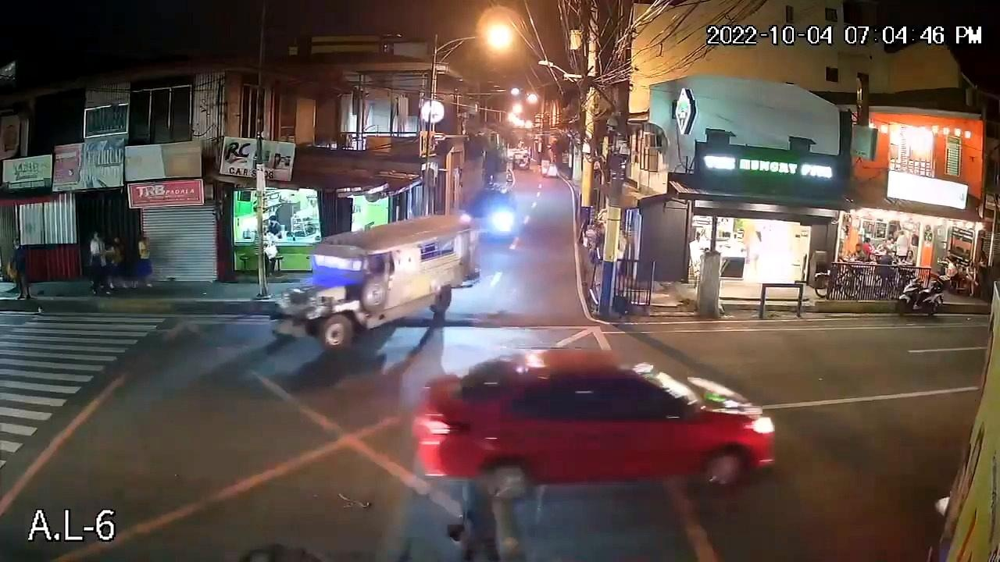

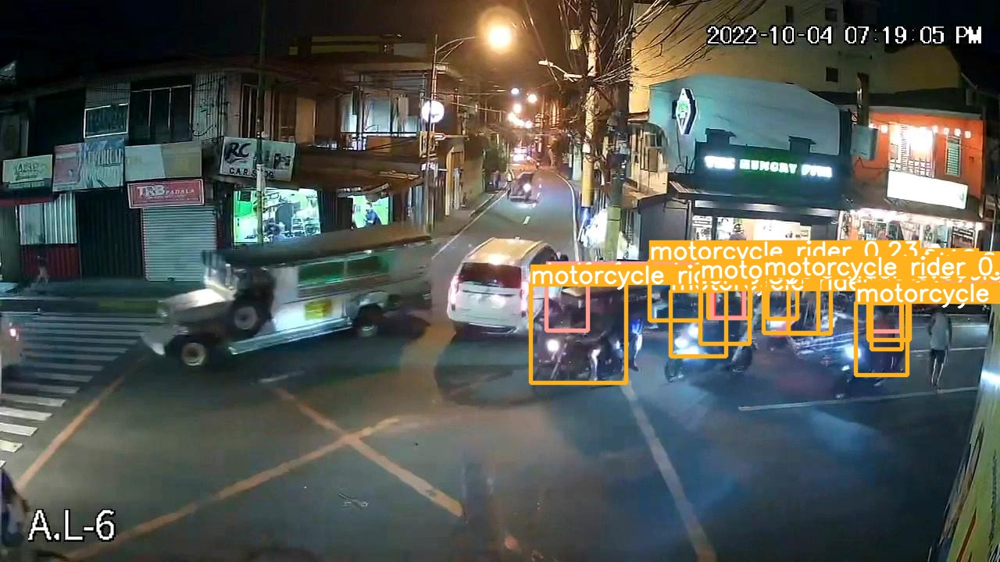

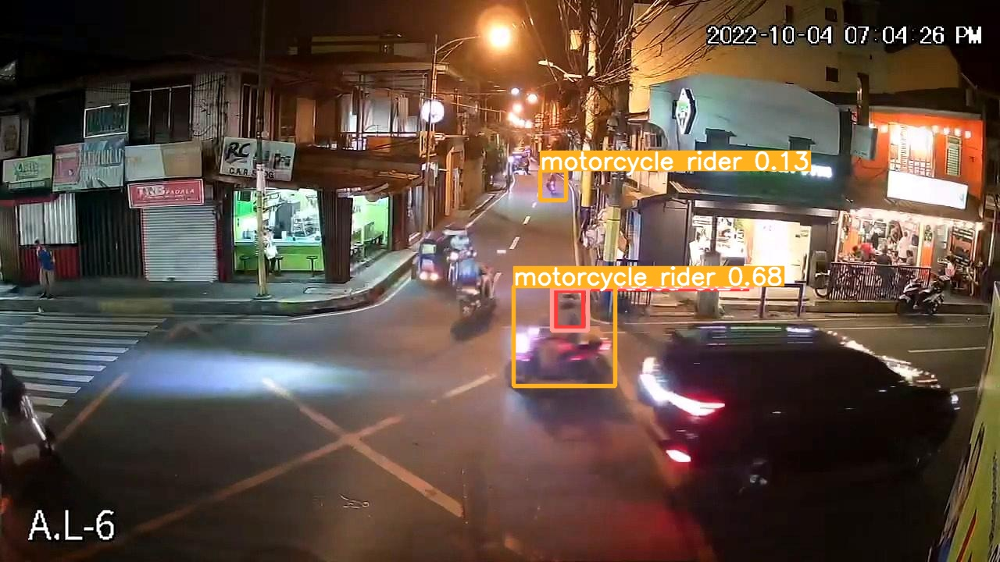

In [ ]:
#display inference on ALL test images
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp9/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
!python /content/yolov5/val.py --weights '/content/yolov5/runs/train/exp3/weights/best.pt' --data /content/datasets/Helmets-1/part3/data.yaml --img 416

val: data=/content/datasets/Helmets-1/part3/data.yaml, weights=['/content/yolov5/runs/train/exp3/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.6, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.1-355-gd3761df Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 290 layers, 20869098 parameters, 0 gradients, 47.9 GFLOPs
val: Scanning '/content/datasets/Helmets-1/part3/valid/labels.cache' images and labels... 44 found, 0 missing, 3 empty, 0 corrupt: 100% 44/44 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 2/2 [00:02<00:00,  1.43s/it]
                 all         44        185      0.501      0.263      0.193     0.0628
          full-faced         44         42      0.399      0.285

In [ ]:
#export your model's weights for future use
from google.colab import files
files.download('/content/yolov5/runs/train/exp9/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### **Testing on Video**

In this section, the model will be tested to the recorded video for testing and validation of the model's performance on real world scenarios. 

In [ ]:
#install opencv-python
%pip install opencv-python

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#upload video file
from google.colab import files
video = files.upload()

Saving part3_Trim.mp4 to part3_Trim.mp4


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!python /content/yolov5/detect.py --weights /content/yolov5/runs/train/exp3/weights/best.pt --img 416 --conf 0.1 --source 'part3_Trim.mp4'

Streaming output truncated to the last 5000 lines.
video 1/1 (10894/15891) /content/yolov5/part3_Trim.mp4: 256x416 1 full-faced, 2 half-faceds, 6 motorcycle riders, Done. (0.011s)
video 1/1 (10895/15891) /content/yolov5/part3_Trim.mp4: 256x416 1 full-faced, 3 half-faceds, 6 motorcycle riders, Done. (0.011s)
video 1/1 (10896/15891) /content/yolov5/part3_Trim.mp4: 256x416 1 full-faced, 3 half-faceds, 7 motorcycle riders, Done. (0.010s)
video 1/1 (10897/15891) /content/yolov5/part3_Trim.mp4: 256x416 1 full-faced, 3 half-faceds, 7 motorcycle riders, Done. (0.011s)
video 1/1 (10898/15891) /content/yolov5/part3_Trim.mp4: 256x416 2 half-faceds, 8 motorcycle riders, Done. (0.014s)
video 1/1 (10899/15891) /content/yolov5/part3_Trim.mp4: 256x416 2 half-faceds, 8 motorcycle riders, Done. (0.011s)
video 1/1 (10900/15891) /content/yolov5/part3_Trim.mp4: 256x416 1 full-faced, 4 half-faceds, 7 motorcycle riders, Done. (0.011s)
video 1/1 (10901/15891) /content/yolov5/part3_Trim.mp4: 256x416 1 full-fac

In [ ]:
files.download('/content/yolov5/runs/detect/exp7/part3_Trim.mp4') #download the video after model detection

NameError: ignored

**Part 1 (5-6pm) Video**



**Part 2 (7-8pm) Video**



**Part 3 (7-8pm) Video**